# Employee Performance Analysis
### INX Future Inc.

## Project Overview:
The goal of this project is to analyze employee performance within the organization and develop predictive models to enhance hiring processes and improve overall performance. The project will focus on four key objectives:

**Problem Statement:**
The organization faces challenges in accurately assessing employee performance, leading to inefficiencies in hiring processes and suboptimal workforce productivity. To address these challenges, the project aims to leverage data analysis and predictive modeling techniques to gain insights into factors influencing employee performance and develop solutions for more effective performance management and hiring.

The project will focus on four key objectives:

1. **Department-wise Performances Analysis:** Analyzing the performance of different departments within the organization to identify strengths, weaknesses, and areas for improvement.

2. **Identification of Top 3 Important Factors Affecting Employee Performance:** Identifying the key factors that significantly influence employee performance through data analysis and statistical modeling.

3. **Development of a Trained Predictive Model:** Building a predictive model that can forecast employee performance based on relevant input factors. This model will be utilized for hiring purposes to select candidates who are likely to perform well in their roles.

4. **Recommendations for Performance Improvement:** Providing actionable recommendations to enhance employee performance based on insights gained from the analysis and predictive modeling.

## Project Deliverables:
1. Department-wise performance report
2. Report on the top 3 factors influencing employee performance
3. prediction A trained model which can predict the employee performance based on factors as inputs. This will be used to hire employees
4. Recommendations for performance improvement

## Potential Challenges:
- Availability and quality of data
- Selection of appropriate performance metrics
- Model complexity and interpretability

## Import Libraries¶

  Which will help for performing a task



In [1]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

In [2]:
# upload a dataset
data=pd.read_excel("INX_Future_Inc_Employee_Performance_CDS_Project2_Data_V1.8.xls")


## Domian Analysis
1. **EmpNumber**: This column likely contains a unique identifier for each employee.

2. **Age**: The age of the employee.
    
3. **Gender**: The gender of the employee. 
    
4. **EducationBackground**: The educational background of the employee, such as their highest level of education attained (e.g., high school diploma, bachelor's degree, etc.). 

5. **MaritalStatus**: The marital status of the employee (e.g., single, married, divorced, etc.).  
                                                                                                                           
6. **EmpDepartment**: The department in which the employee works. 
                                                                                                                           
7. **EmpJobRole**: The specific job role or position of the employee within their department. 
                                                                                                                           
8. **BusinessTravelFrequency**: How frequently the employee travels for business purposes.  
                                    
9. **DistanceFromHome**: The distance between the employee's home and their workplace.  
                                                                                                                           
10. **EmpEducationLevel**: The education level of the employee, which could be related to their qualifications and skill level.

11. **EmpEnvironmentSatisfaction**: The level of satisfaction the employee feels with their work environment.  
                                                                                                                           
12. **EmpHourlyRate**: The employee's hourly rate of pay.  
                                                                                                                           
13. **EmpJobInvolvement**: The level of involvement or engagement the employee has in their job role.  
                                                                                                                           
14. **EmpJobLevel**: The hierarchical level of the employee's job role within the company. Higher job levels may be associated with greater responsibilities and potentially higher performance expectations.

15. **EmpJobSatisfaction**: The level of job satisfaction reported by the employee.  
                                                                                                                           
16. **NumCompaniesWorked**: The number of companies the employee has worked for previously.  
                                                                                                                           
17. **OverTime**: Whether the employee works overtime or not.  
                                                                                                                           
18. **EmpLastSalaryHikePercent**: The percentage of the employee's last salary hike.  
                                                                                                                           
19. **EmpRelationshipSatisfaction**: The level of satisfaction the employee feels with their relationships at work.  
                                                                                                                           
20. **TotalWorkExperienceInYears**: The total work experience of the employee in years.  
                                                                                                                           
21. **TrainingTimesLastYear**: The number of times the employee received training in the last year. 
                                                                                                                           
22. **EmpWorkLifeBalance**: The employee's perceived work-life balance.  
                                                                                                                           
23. **ExperienceYearsAtThisCompany**: The number of years the employee has worked at INX Future Inc.  
                                                                                                                           
24. **ExperienceYearsInCurrentRole**: The number of years the employee has been in their current job role.  
                                                                                                                           
25. **YearsSinceLastPromotion**: The number of years since the employee's last promotion.  
                                                                                                                           
26. **YearsWithCurrManager**: The number of years the employee has been working with their current manager. 
                                                                                                                           
27. **Attrition**: Whether the employee has left the company or not.  
                                                                                                                           
28. **PerformanceRating**: The performance rating assigned to the employee.
 

### Basic Ckeck

In [5]:
# Set Pandas display options to show all rows and columns
pd.set_option('display.max_rows', None)  # None means unlimited
pd.set_option('display.max_columns', None)
data

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,E1001000,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,4,55,3,2,4,1,No,12,4,10,2,2,10,7,0,8,No,3
1,E1001006,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,4,42,3,2,1,2,No,12,4,20,2,3,7,7,1,7,No,3
2,E1001007,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,4,48,2,3,1,5,Yes,21,3,20,2,3,18,13,1,12,No,4
3,E1001009,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,2,73,2,5,4,3,No,15,2,23,2,2,21,6,12,6,No,3
4,E1001010,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,1,84,3,2,1,8,No,14,4,10,1,3,2,2,2,2,No,3
5,E1001011,27,Male,Life Sciences,Divorced,Development,Developer,Travel_Frequently,10,2,4,32,3,3,1,1,No,21,3,9,4,2,9,7,1,7,No,4
6,E1001016,50,Male,Marketing,Married,Sales,Sales Representative,Travel_Rarely,8,4,4,54,3,1,2,7,No,15,4,4,2,3,2,2,2,2,No,3
7,E1001019,28,Female,Life Sciences,Single,Development,Developer,Travel_Rarely,1,2,1,67,1,1,2,7,Yes,13,4,10,4,3,7,7,3,7,Yes,3
8,E1001020,36,Female,Life Sciences,Married,Development,Developer,Non-Travel,8,3,1,63,4,3,1,9,No,14,1,10,2,3,8,7,0,5,No,3
9,E1001021,38,Female,Life Sciences,Single,Development,Developer,Travel_Rarely,1,3,3,81,3,3,3,4,Yes,14,4,10,4,4,1,0,0,0,No,3


In [7]:
#Checking size of data
data.size

33600

In [8]:
#Checking shape of data
data.shape

(1200, 28)

In [9]:
#Checking dimension of data
data.ndim

2

In [10]:
#Checking data type of data
data.dtypes

EmpNumber                       object
Age                              int64
Gender                          object
EducationBackground             object
MaritalStatus                   object
EmpDepartment                   object
EmpJobRole                      object
BusinessTravelFrequency         object
DistanceFromHome                 int64
EmpEducationLevel                int64
EmpEnvironmentSatisfaction       int64
EmpHourlyRate                    int64
EmpJobInvolvement                int64
EmpJobLevel                      int64
EmpJobSatisfaction               int64
NumCompaniesWorked               int64
OverTime                        object
EmpLastSalaryHikePercent         int64
EmpRelationshipSatisfaction      int64
TotalWorkExperienceInYears       int64
TrainingTimesLastYear            int64
EmpWorkLifeBalance               int64
ExperienceYearsAtThisCompany     int64
ExperienceYearsInCurrentRole     int64
YearsSinceLastPromotion          int64
YearsWithCurrManager     

In [11]:
#Checking information of data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 28 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   EmpNumber                     1200 non-null   object
 1   Age                           1200 non-null   int64 
 2   Gender                        1200 non-null   object
 3   EducationBackground           1200 non-null   object
 4   MaritalStatus                 1200 non-null   object
 5   EmpDepartment                 1200 non-null   object
 6   EmpJobRole                    1200 non-null   object
 7   BusinessTravelFrequency       1200 non-null   object
 8   DistanceFromHome              1200 non-null   int64 
 9   EmpEducationLevel             1200 non-null   int64 
 10  EmpEnvironmentSatisfaction    1200 non-null   int64 
 11  EmpHourlyRate                 1200 non-null   int64 
 12  EmpJobInvolvement             1200 non-null   int64 
 13  EmpJobLevel       

In [12]:
#fetching all columns who available in our data
data.columns

Index(['EmpNumber', 'Age', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency',
       'DistanceFromHome', 'EmpEducationLevel', 'EmpEnvironmentSatisfaction',
       'EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel',
       'EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime',
       'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfaction',
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition', 'PerformanceRating'],
      dtype='object')

In [13]:
data.describe()

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,PerformanceRating
count,1200.000000,1200.000000,1200.00000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000
mean,36.918333,9.165833,2.89250,2.715833,65.981667,2.731667,2.067500,2.732500,2.665000,15.222500,2.725000,11.330000,2.785833,2.744167,7.077500,4.291667,2.194167,4.105000,2.948333
std,9.087289,8.176636,1.04412,1.090599,20.211302,0.707164,1.107836,1.100888,2.469384,3.625918,1.075642,7.797228,1.263446,0.699374,6.236899,3.613744,3.221560,3.541576,0.518866
min,18.000000,1.000000,1.00000,1.000000,30.000000,1.000000,1.000000,1.000000,0.000000,11.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000
25%,30.000000,2.000000,2.00000,2.000000,48.000000,2.000000,1.000000,2.000000,1.000000,12.000000,2.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000,3.000000
50%,36.000000,7.000000,3.00000,3.000000,66.000000,3.000000,2.000000,3.000000,2.000000,14.000000,3.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000,3.000000
75%,43.000000,14.000000,4.00000,4.000000,83.000000,3.000000,3.000000,4.000000,4.000000,18.000000,4.000000,15.000000,3.000000,3.000000,10.000000,7.000000,3.000000,7.000000,3.000000
max,60.000000,29.000000,5.00000,4.000000,100.000000,4.000000,5.000000,4.000000,9.000000,25.000000,4.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000,4.000000


In [14]:
# fetching numerical columns
num_col=data.select_dtypes(include=["int64","float64"]).columns
num_col

Index(['Age', 'DistanceFromHome', 'EmpEducationLevel',
       'EmpEnvironmentSatisfaction', 'EmpHourlyRate', 'EmpJobInvolvement',
       'EmpJobLevel', 'EmpJobSatisfaction', 'NumCompaniesWorked',
       'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfaction',
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'PerformanceRating'],
      dtype='object')

In [15]:
# fetching categorical columns
cat_col=data.select_dtypes(include=["object"])
cat_col.columns

Index(['EmpNumber', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency', 'OverTime',
       'Attrition'],
      dtype='object')

In [16]:
# fetching unique value (means how many type of value available in dataset) in secepic columns 
print(data['EducationBackground'].unique())
print(data['EmpDepartment'].unique())
print(data['EmpJobRole'].unique())
print(data['EmpEducationLevel'].unique())
print(data['EmpEnvironmentSatisfaction'].unique())
print(data['EmpHourlyRate'].unique())
print(data['NumCompaniesWorked'].unique())
print(data['TotalWorkExperienceInYears'].unique())
print(data['ExperienceYearsAtThisCompany'].unique())
print(data['YearsSinceLastPromotion'].unique())
print(data['Attrition'].unique())

['Marketing' 'Life Sciences' 'Human Resources' 'Medical' 'Other'
 'Technical Degree']
['Sales' 'Human Resources' 'Development' 'Data Science'
 'Research & Development' 'Finance']
['Sales Executive' 'Manager' 'Developer' 'Sales Representative'
 'Human Resources' 'Senior Developer' 'Data Scientist'
 'Senior Manager R&D' 'Laboratory Technician' 'Manufacturing Director'
 'Research Scientist' 'Healthcare Representative' 'Research Director'
 'Manager R&D' 'Finance Manager' 'Technical Architect' 'Business Analyst'
 'Technical Lead' 'Delivery Manager']
[3 4 2 5 1]
[4 2 1 3]
[ 55  42  48  73  84  32  54  67  63  81  49  99  57  96  44  86  83  61
  80  31  46  79  77  60  76  41  71  66  38  72  95  82  75  93  64  36
  69  33  35  40  43  51  52  98  45  37  94  59  88  50  65  53  56  78
  74  91  62  87  68  34  70 100  92  39  97  47  90  85  30  58  89]
[1 2 5 3 8 7 9 4 6 0]
[10 20 23  9  4 28  1  7 12 30  5  2 19 16 34  6  8 11 17  3 14 26 13 22
  0 29 18 35 33 31 24 15 32 21 27 25 36 37 

In [17]:
data.PerformanceRating.value_counts()

3    874
2    194
4    132
Name: PerformanceRating, dtype: int64

### Univariant

<Axes: xlabel='PerformanceRating', ylabel='count'>

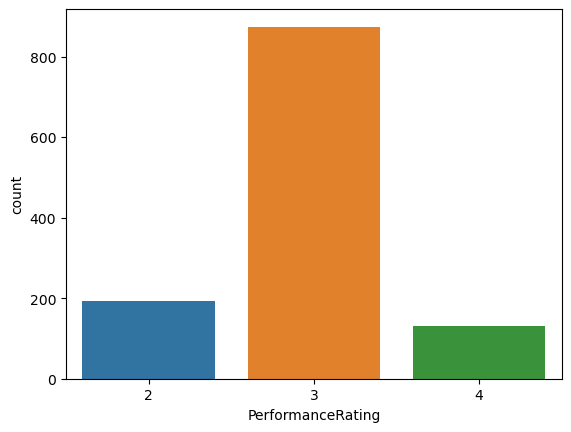

In [18]:
# check whether data is balanced or not
# data balanced: Equal number of records related to performance or not
sns.countplot(x=data.PerformanceRating)


- Our target variable's Data is not balenced
- Means that is imbalence data



In [19]:
data.PerformanceRating.value_counts()

3    874
2    194
4    132
Name: PerformanceRating, dtype: int64

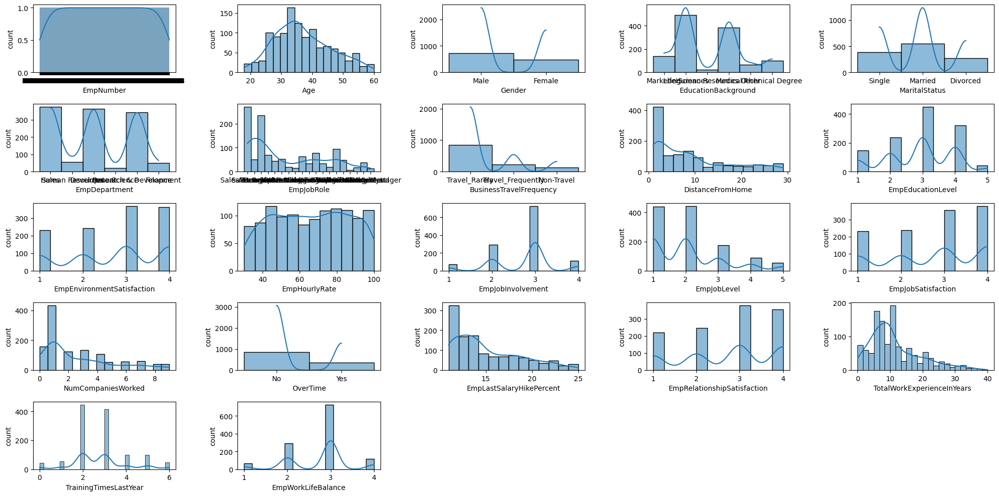

In [20]:
# checking distrubution of data
plt.figure(figsize=(20,10),facecolor='white')
plotnumber=1
for column in data.drop('PerformanceRating',axis=1):
    if plotnumber<=22:
        ax=plt.subplot(5,5,plotnumber)
        sns.histplot(x=data[column],kde=True)
        plt.xlabel(column,fontsize=10)
        plt.ylabel("count",fontsize=10)
    plotnumber+=1
plt.tight_layout()

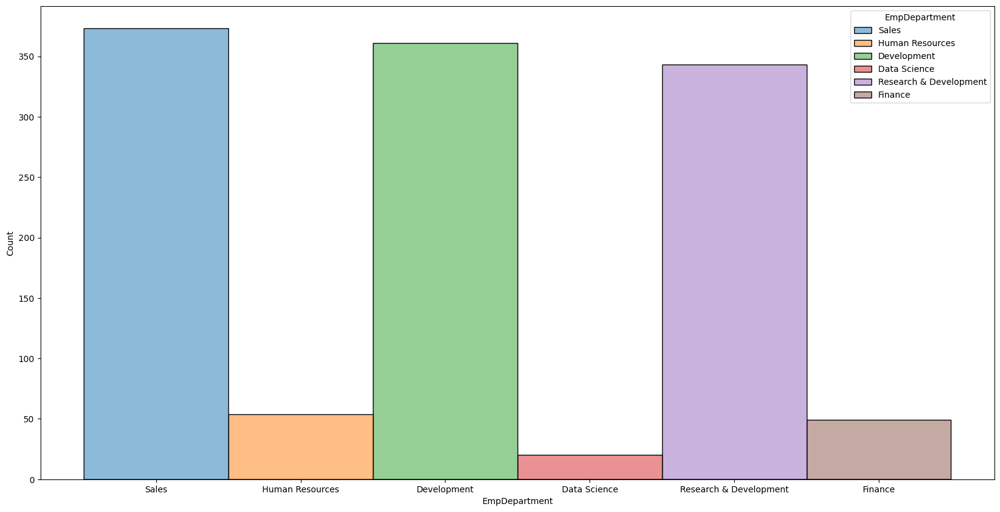

In [21]:
plt.figure(figsize=(20,10))
sns.histplot(data=data,x='EmpDepartment',kde=True,hue='EmpDepartment')
plt.show()

<Axes: xlabel='ExperienceYearsAtThisCompany', ylabel='count'>

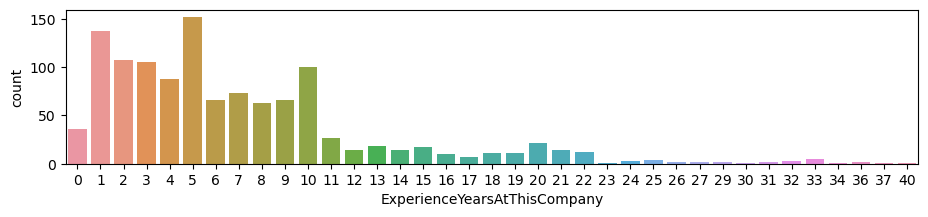

In [22]:
plt.figure(figsize=(11,2))
sns.countplot(data=data,x='ExperienceYearsAtThisCompany')

In [23]:
# library mostly use for univariant analysis that why have to use
import sweetviz as sv
my_report = sv.analyze(data)
my_report.show_html('myreportEmp.html') # Default arguments will generate to "SWEETVIZ_REPORT.html"

                                             |                                             | [  0%]   00:00 ->…

Report myreportEmp.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


 
   - we can apply the sweetviz library to perform univariate exploratory data analysis (EDA) efficiently.
   - Quick Data Overview: sweetviz helps you get a quick and comprehensive overview of your dataset. It generates visualizations and statistics that summarize data, making it easier to understand its characteristics.
   - Data Comparison: You can use sweetviz to compare two datasets, such as a training dataset and a test dataset, to identify any differences or discrepancies.
   - Feature Analysis: It provides insights into individual features (columns) by visualizing their distributions and statistics. This is helpful for understanding the data within each feature.
   - Target Analysis: If we'll working on a classification or regression problem, sweetviz can analyze the relationship between features and the target variable, helping you identify important predictors.





### Insights from univariant analysis

- Employee between the age group 30-35 are the majority.
- 70% of the people travel raraely, 20% travel frequently rest do not travel.
- Majority of the employees belong to research and development.
- Almost 35% of the people are nearer to the office i.e the distance from their home is lesser than or equal to 10.
- More than 60% of the people have educational qualification of 2 and 4.
- Majority(40%) of the people are from life science field and 30% are from medical field.
- 60% of the people are almost satisfied with environment condition of the office with more than 3 and 4 ratings.
- Gender count: 60% male 40% female.
- Almost 40% of the people have partial involvement in job and 20% have good involvement.
- More than 45% employees seem to be satisfied with their job.
- 50% of the people are married, 30% single and the rest are divorced.
- 40% of the employee have worked experience less than 10 year 
- 15% of the people have worked for less than 1 company which implies they are freshers.
- 30% of the people have worked for more than 5 companies.
- 80% of the people have average work rating.




### Bivariant

<Axes: xlabel='Age', ylabel='ExperienceYearsAtThisCompany'>

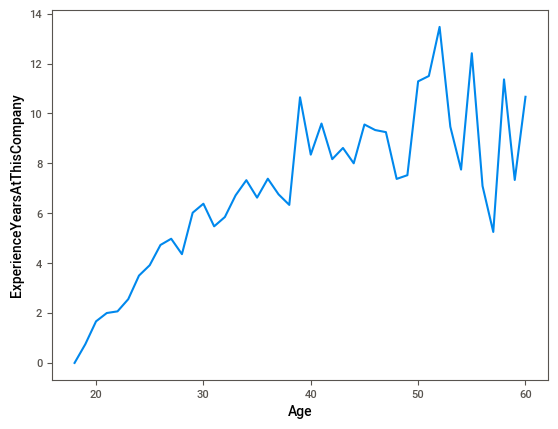

In [24]:
# line plot
sns.lineplot(data=data,x='Age',y='ExperienceYearsAtThisCompany',ci=None)

- Here I was comparing Experience at company in year with Age

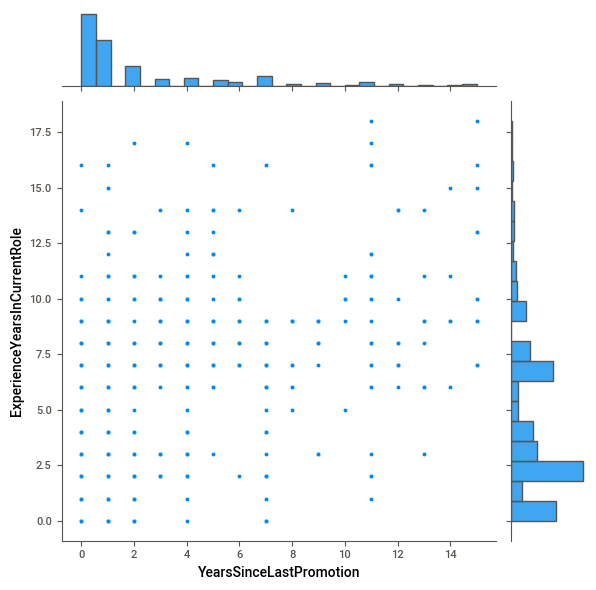

In [25]:
sns.jointplot(data=data,x='YearsSinceLastPromotion',y='ExperienceYearsInCurrentRole',kind="scatter")
plt.show()

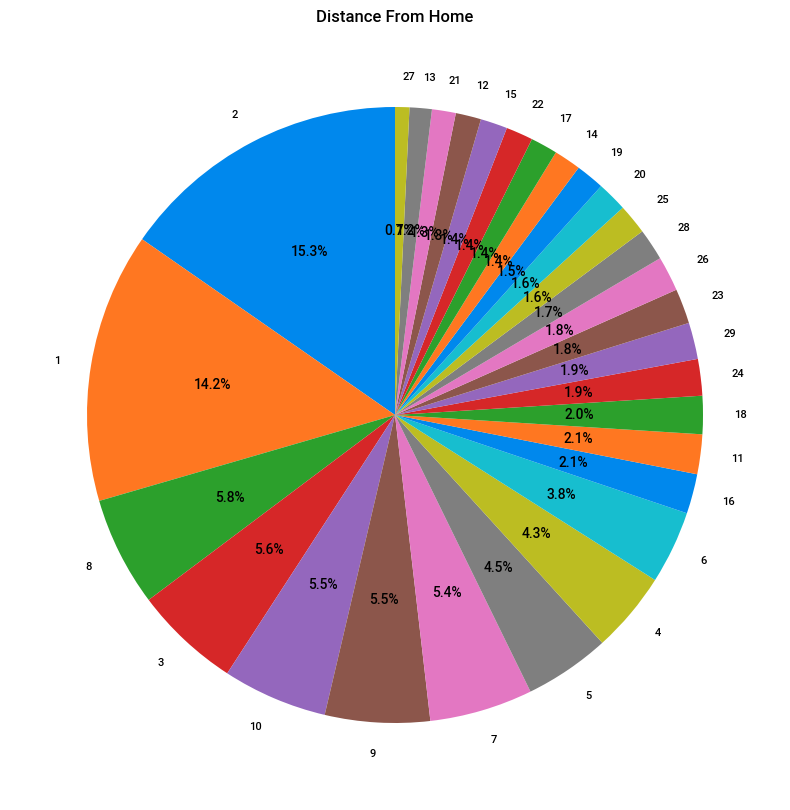

In [26]:
# Show Distribution of Delivery_Mode

plt.figure(figsize=(12, 10))
data['DistanceFromHome'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
plt.title('Distance From Home')
plt.ylabel('')
plt.show()

<Figure size 700x800 with 0 Axes>

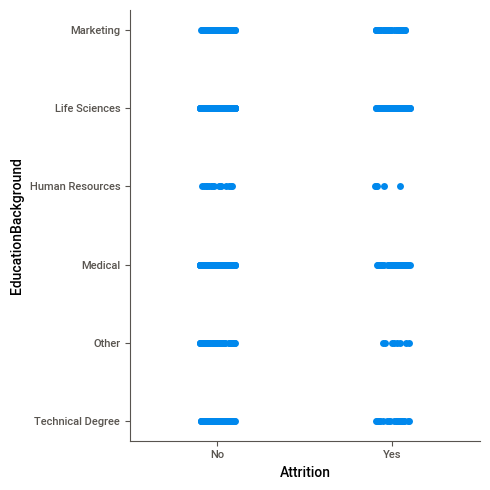

In [27]:
# bar plot
plt.figure(figsize=(7,8))
sns.catplot(data=data,x='Attrition',y='EducationBackground')
plt.show() 

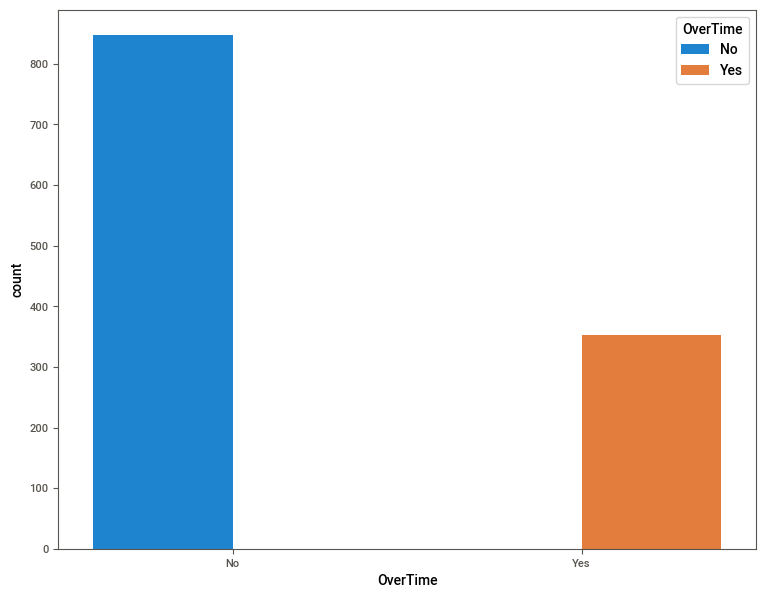

In [28]:
plt.figure(figsize=(9,7))
sns.countplot(data=data, x='OverTime', hue='OverTime')
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
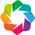

Imported v0.1.720. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (1200, 28)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing upto 30 columns max in each category:
    Numeric Columns : []
    Integer-Categorical Columns: ['Age', 'DistanceFromHome', 'EmpEducationLevel', 'EmpEnvironmentSatisfaction', 'EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel', 'EmpJobSatisfaction', 'NumCompaniesWorked', 'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfa

Saving distplots_nums in HTML format
Saving violinplots in HTML format                                                                                      
Saving heatmaps in HTML format
Saving cat_var_plots in HTML format


Time to run AutoViz (in seconds) = 23


In [29]:
# here using autoviz in bivariant
from autoviz.AutoViz_Class import AutoViz_Class
AV=AutoViz_Class()
data=AV.AutoViz(filename="INX_Future_Inc_Employee_Performance_CDS_Project2_Data_V1.8.xls",verbose=2,chart_format='html')

### Insights from bivariant analysis

- More male employees are expected to quit their job.
- People who travel more are more expected to leave the job.
- People who do not do overtime do not leave the job.
- Singles are expected to quit the job.
- People from Devlopment, Senior devloper and sales executive are more probablyu leaving their job.



### Multiveriant

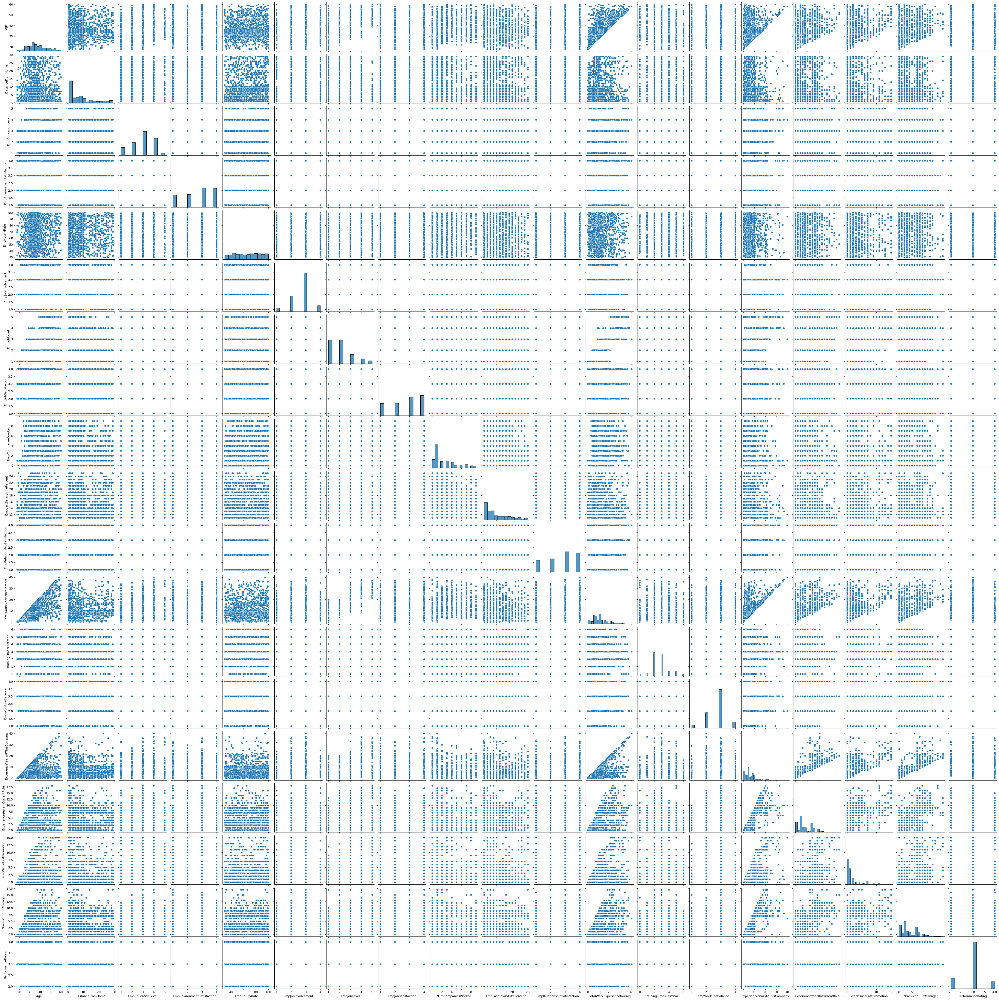

In [5]:
sns.pairplot(data=data)

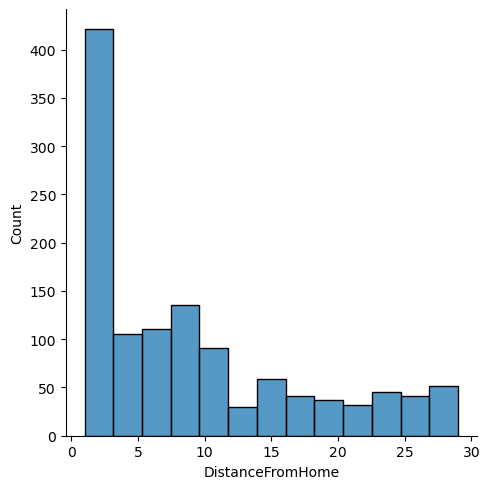

In [4]:
sns.displot(x=data['DistanceFromHome'])

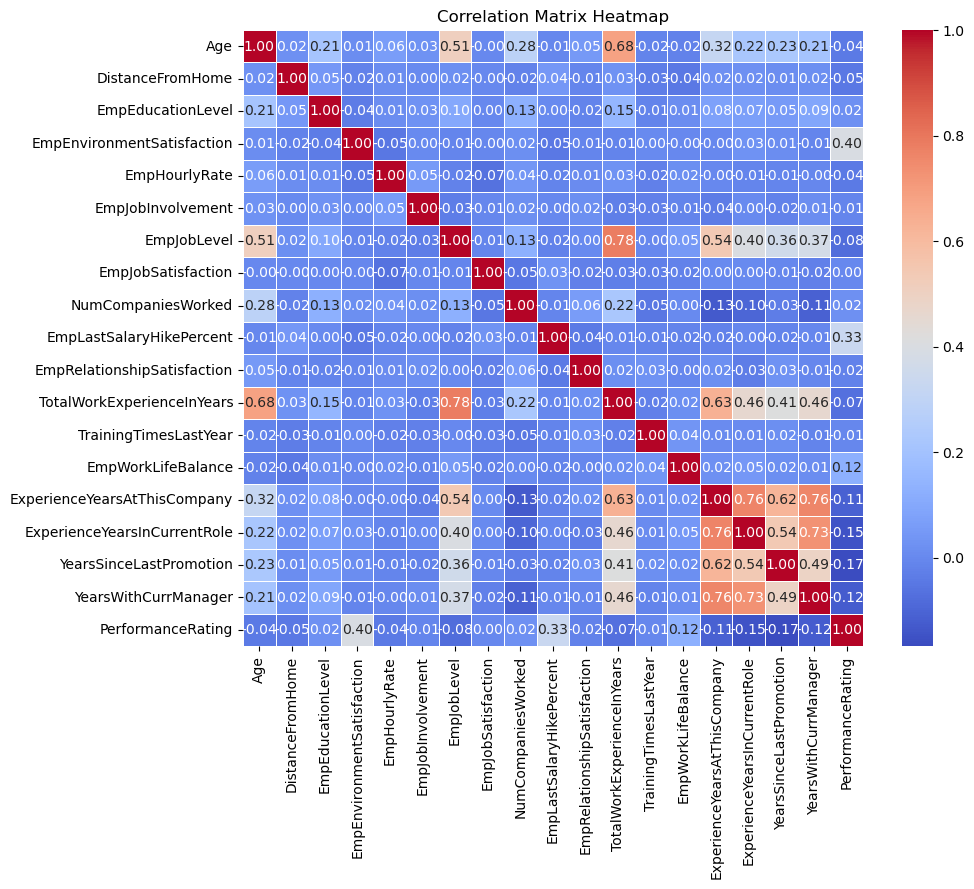

In [3]:
correlation_matrix = data.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix Heatmap")
plt.show()

### Final conclusions¶

EmployeeTravel : The workers who travel alot are more likely to quit then other employees.

Department : The worker in Research & manager are more likely to stay then the workers on other departement.

EducationField : The workers with Human Resources and Technical Degree are more likely to quit then employees from other fields of educations.

Gender : The Male are more likely to quit.

JobRole : The workers in Developer, Human Resources, Senior Develo are more likely to quit the workers in other positions.

MaritalStatus : The workers who have Single marital status are more likely to quit the Married, and Divorced.

OverTime :Over time rate is almost equal


### Data Preprocessing

In [34]:
# check percentage of missing values
data.isnull().sum()/len(data)*100

EmpNumber                       0.0
Age                             0.0
Gender                          0.0
EducationBackground             0.0
MaritalStatus                   0.0
EmpDepartment                   0.0
EmpJobRole                      0.0
BusinessTravelFrequency         0.0
DistanceFromHome                0.0
EmpEducationLevel               0.0
EmpEnvironmentSatisfaction      0.0
EmpHourlyRate                   0.0
EmpJobInvolvement               0.0
EmpJobLevel                     0.0
EmpJobSatisfaction              0.0
NumCompaniesWorked              0.0
OverTime                        0.0
EmpLastSalaryHikePercent        0.0
EmpRelationshipSatisfaction     0.0
TotalWorkExperienceInYears      0.0
TrainingTimesLastYear           0.0
EmpWorkLifeBalance              0.0
ExperienceYearsAtThisCompany    0.0
ExperienceYearsInCurrentRole    0.0
YearsSinceLastPromotion         0.0
YearsWithCurrManager            0.0
Attrition                       0.0
PerformanceRating           

In [35]:
# we do not have any null values
# we have 2 constant features Atrrition and PerformanceRating
 

In [36]:
data.isnull().sum()

EmpNumber                       0
Age                             0
Gender                          0
EducationBackground             0
MaritalStatus                   0
EmpDepartment                   0
EmpJobRole                      0
BusinessTravelFrequency         0
DistanceFromHome                0
EmpEducationLevel               0
EmpEnvironmentSatisfaction      0
EmpHourlyRate                   0
EmpJobInvolvement               0
EmpJobLevel                     0
EmpJobSatisfaction              0
NumCompaniesWorked              0
OverTime                        0
EmpLastSalaryHikePercent        0
EmpRelationshipSatisfaction     0
TotalWorkExperienceInYears      0
TrainingTimesLastYear           0
EmpWorkLifeBalance              0
ExperienceYearsAtThisCompany    0
ExperienceYearsInCurrentRole    0
YearsSinceLastPromotion         0
YearsWithCurrManager            0
Attrition                       0
PerformanceRating               0
dtype: int64

In [37]:
# Checking mean median and mode
print(data.mean())
print(data.median())
print(data.mode())

Age                             36.918333
DistanceFromHome                 9.165833
EmpEducationLevel                2.892500
EmpEnvironmentSatisfaction       2.715833
EmpHourlyRate                   65.981667
EmpJobInvolvement                2.731667
EmpJobLevel                      2.067500
EmpJobSatisfaction               2.732500
NumCompaniesWorked               2.665000
EmpLastSalaryHikePercent        15.222500
EmpRelationshipSatisfaction      2.725000
TotalWorkExperienceInYears      11.330000
TrainingTimesLastYear            2.785833
EmpWorkLifeBalance               2.744167
ExperienceYearsAtThisCompany     7.077500
ExperienceYearsInCurrentRole     4.291667
YearsSinceLastPromotion          2.194167
YearsWithCurrManager             4.105000
PerformanceRating                2.948333
dtype: float64
Age                             36.0
DistanceFromHome                 7.0
EmpEducationLevel                3.0
EmpEnvironmentSatisfaction       3.0
EmpHourlyRate                   66.0
Em

In [38]:
data.PerformanceRating.value_counts()

3    874
2    194
4    132
Name: PerformanceRating, dtype: int64

In [39]:
#And here I'm deteting Employee Number column becouse there It's helpfull for us co
data.drop(columns=['EmpNumber'], inplace=True)

In [40]:
print(data.columns)

Index(['Age', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency',
       'DistanceFromHome', 'EmpEducationLevel', 'EmpEnvironmentSatisfaction',
       'EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel',
       'EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime',
       'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfaction',
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition', 'PerformanceRating'],
      dtype='object')


In [41]:
df = pd.DataFrame(data)

# Filter columns with object (string) data type
object_columns = df.select_dtypes(include=['object'])

# Iterate through object columns and print unique values
for column in object_columns.columns:
    unique_values = df[column].unique()
    print(f"Unique values in column '{column}': {', '.join(unique_values)}")

Unique values in column 'Gender': Male, Female
Unique values in column 'EducationBackground': Marketing, Life Sciences, Human Resources, Medical, Other, Technical Degree
Unique values in column 'MaritalStatus': Single, Married, Divorced
Unique values in column 'EmpDepartment': Sales, Human Resources, Development, Data Science, Research & Development, Finance
Unique values in column 'EmpJobRole': Sales Executive, Manager, Developer, Sales Representative, Human Resources, Senior Developer, Data Scientist, Senior Manager R&D, Laboratory Technician, Manufacturing Director, Research Scientist, Healthcare Representative, Research Director, Manager R&D, Finance Manager, Technical Architect, Business Analyst, Technical Lead, Delivery Manager
Unique values in column 'BusinessTravelFrequency': Travel_Rarely, Travel_Frequently, Non-Travel
Unique values in column 'OverTime': No, Yes
Unique values in column 'Attrition': No, Yes


### Checking outliers 

In [42]:
# After Encoding

#### Data Encoding

In [43]:
print(data.dtypes,data.nunique())

Age                              int64
Gender                          object
EducationBackground             object
MaritalStatus                   object
EmpDepartment                   object
EmpJobRole                      object
BusinessTravelFrequency         object
DistanceFromHome                 int64
EmpEducationLevel                int64
EmpEnvironmentSatisfaction       int64
EmpHourlyRate                    int64
EmpJobInvolvement                int64
EmpJobLevel                      int64
EmpJobSatisfaction               int64
NumCompaniesWorked               int64
OverTime                        object
EmpLastSalaryHikePercent         int64
EmpRelationshipSatisfaction      int64
TotalWorkExperienceInYears       int64
TrainingTimesLastYear            int64
EmpWorkLifeBalance               int64
ExperienceYearsAtThisCompany     int64
ExperienceYearsInCurrentRole     int64
YearsSinceLastPromotion          int64
YearsWithCurrManager             int64
Attrition                

In [44]:
## data encoding 
#Convert categorical y column into numerical using lable encoding

from sklearn.preprocessing import LabelEncoder#importing label encoder from sklearn 

label = LabelEncoder()#object creation 
data.Attrition=label.fit_transform(data.Attrition)#applying label encoder to  Attrition 
data.OverTime=label.fit_transform(data.OverTime)#applying label encoder to  OverTime

In [45]:
print(data.Attrition.value_counts())
print(data.OverTime.value_counts())

0    1022
1     178
Name: Attrition, dtype: int64
0    847
1    353
Name: OverTime, dtype: int64


In [46]:
# Convert categorical variables into numerical using one-hot encoding
data_encoded= pd.get_dummies(data, columns=['Gender', 'EducationBackground', 'MaritalStatus',
                                            'EmpDepartment','EmpJobRole','BusinessTravelFrequency'])

In [47]:
data_encoded

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating,Gender_Female,Gender_Male,EducationBackground_Human Resources,EducationBackground_Life Sciences,EducationBackground_Marketing,EducationBackground_Medical,EducationBackground_Other,EducationBackground_Technical Degree,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,EmpDepartment_Data Science,EmpDepartment_Development,EmpDepartment_Finance,EmpDepartment_Human Resources,EmpDepartment_Research & Development,EmpDepartment_Sales,EmpJobRole_Business Analyst,EmpJobRole_Data Scientist,EmpJobRole_Delivery Manager,EmpJobRole_Developer,EmpJobRole_Finance Manager,EmpJobRole_Healthcare Representative,EmpJobRole_Human Resources,EmpJobRole_Laboratory Technician,EmpJobRole_Manager,EmpJobRole_Manager R&D,EmpJobRole_Manufacturing Director,EmpJobRole_Research Director,EmpJobRole_Research Scientist,EmpJobRole_Sales Executive,EmpJobRole_Sales Representative,EmpJobRole_Senior Developer,EmpJobRole_Senior Manager R&D,EmpJobRole_Technical Architect,EmpJobRole_Technical Lead,BusinessTravelFrequency_Non-Travel,BusinessTravelFrequency_Travel_Frequently,BusinessTravelFrequency_Travel_Rarely
0,32,10,3,4,55,3,2,4,1,0,12,4,10,2,2,10,7,0,8,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
1,47,14,4,4,42,3,2,1,2,0,12,4,20,2,3,7,7,1,7,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
2,40,5,4,4,48,2,3,1,5,1,21,3,20,2,3,18,13,1,12,0,4,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
3,41,10,4,2,73,2,5,4,3,0,15,2,23,2,2,21,6,12,6,0,3,0,1,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
4,60,16,4,1,84,3,2,1,8,0,14,4,10,1,3,2,2,2,2,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,27,3,1,4,71,4,2,4,1,1,20,2,6,3,3,6,5,0,4,0,4,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
1196,37,10,2,4,80,4,1,4,3,0,17,1,4,2,3,1,0,0,0,0,3,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1197,50,28,1,4,74,4,1,3,1,1,11,3,20,3,3,20,8,3,8,0,3,0,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1198,34,9,3,4,46,2,3,2,1,0,14,2,9,3,4,8,7,7,7,0,3,1,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [48]:
# Now we are trying to save these to diffrent name file.
data_encoded.to_csv('DummiesFile.csv', index=False)

In [6]:
# Loading dataset
data1=pd.read_csv('DummiesFile.csv')

In [50]:
data1.shape

(1200, 60)

In [51]:
data1

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating,Gender_Female,Gender_Male,EducationBackground_Human Resources,EducationBackground_Life Sciences,EducationBackground_Marketing,EducationBackground_Medical,EducationBackground_Other,EducationBackground_Technical Degree,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,EmpDepartment_Data Science,EmpDepartment_Development,EmpDepartment_Finance,EmpDepartment_Human Resources,EmpDepartment_Research & Development,EmpDepartment_Sales,EmpJobRole_Business Analyst,EmpJobRole_Data Scientist,EmpJobRole_Delivery Manager,EmpJobRole_Developer,EmpJobRole_Finance Manager,EmpJobRole_Healthcare Representative,EmpJobRole_Human Resources,EmpJobRole_Laboratory Technician,EmpJobRole_Manager,EmpJobRole_Manager R&D,EmpJobRole_Manufacturing Director,EmpJobRole_Research Director,EmpJobRole_Research Scientist,EmpJobRole_Sales Executive,EmpJobRole_Sales Representative,EmpJobRole_Senior Developer,EmpJobRole_Senior Manager R&D,EmpJobRole_Technical Architect,EmpJobRole_Technical Lead,BusinessTravelFrequency_Non-Travel,BusinessTravelFrequency_Travel_Frequently,BusinessTravelFrequency_Travel_Rarely
0,32,10,3,4,55,3,2,4,1,0,12,4,10,2,2,10,7,0,8,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
1,47,14,4,4,42,3,2,1,2,0,12,4,20,2,3,7,7,1,7,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
2,40,5,4,4,48,2,3,1,5,1,21,3,20,2,3,18,13,1,12,0,4,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
3,41,10,4,2,73,2,5,4,3,0,15,2,23,2,2,21,6,12,6,0,3,0,1,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
4,60,16,4,1,84,3,2,1,8,0,14,4,10,1,3,2,2,2,2,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,27,3,1,4,71,4,2,4,1,1,20,2,6,3,3,6,5,0,4,0,4,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
1196,37,10,2,4,80,4,1,4,3,0,17,1,4,2,3,1,0,0,0,0,3,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1197,50,28,1,4,74,4,1,3,1,1,11,3,20,3,3,20,8,3,8,0,3,0,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1198,34,9,3,4,46,2,3,2,1,0,14,2,9,3,4,8,7,7,7,0,3,1,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


### Outliers

In [52]:
# checking Outliers 
plt.figure(figsize=(10,5),facecolor='white')
plotnumber=1
for column in data1.drop('PerformanceRating',axis=1):
    if plotnumber<9:
        ax=plt.subplot(4,5,plotnumber)
        sns.boxplot(x=data1[column])
        plt.xlabel(column,fontsize=10)
        plt.ylabel("count",fontsize=10)
    plotnumber+=1
plt.tight_layout()

### Feture Selection

In [53]:
data1.corr()

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating,Gender_Female,Gender_Male,EducationBackground_Human Resources,EducationBackground_Life Sciences,EducationBackground_Marketing,EducationBackground_Medical,EducationBackground_Other,EducationBackground_Technical Degree,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,EmpDepartment_Data Science,EmpDepartment_Development,EmpDepartment_Finance,EmpDepartment_Human Resources,EmpDepartment_Research & Development,EmpDepartment_Sales,EmpJobRole_Business Analyst,EmpJobRole_Data Scientist,EmpJobRole_Delivery Manager,EmpJobRole_Developer,EmpJobRole_Finance Manager,EmpJobRole_Healthcare Representative,EmpJobRole_Human Resources,EmpJobRole_Laboratory Technician,EmpJobRole_Manager,EmpJobRole_Manager R&D,EmpJobRole_Manufacturing Director,EmpJobRole_Research Director,EmpJobRole_Research Scientist,EmpJobRole_Sales Executive,EmpJobRole_Sales Representative,EmpJobRole_Senior Developer,EmpJobRole_Senior Manager R&D,EmpJobRole_Technical Architect,EmpJobRole_Technical Lead,BusinessTravelFrequency_Non-Travel,BusinessTravelFrequency_Travel_Frequently,BusinessTravelFrequency_Travel_Rarely
Age,1.000000,0.020937,0.207313,0.013814,0.062867,0.027216,0.509139,-0.002436,0.284408,0.051910,-0.006105,0.049749,0.680886,-0.016053,-0.019563,0.318852,0.217163,0.228199,0.205098,-0.189317,-0.040164,0.040107,-0.040107,-0.000199,0.020365,0.045058,0.004791,-0.062217,-4.475563e-02,0.039185,0.078782,-0.119111,0.015503,-0.019107,-0.012052,0.036028,0.038785,-0.034200,-0.014152,0.015503,1.565617e-02,-0.030634,-0.012052,0.055928,-0.010781,-0.078707,0.243837,0.051105,0.058172,0.056260,-0.048561,-0.018004,-0.175906,-0.002592,0.005966,-0.024610,0.033584,-2.293464e-02,-0.033992,0.044678
DistanceFromHome,0.020937,1.000000,0.045856,-0.017719,0.013730,0.003231,0.017270,-0.003036,-0.021411,0.024940,0.044974,-0.009509,0.027306,-0.032082,-0.044788,0.021908,0.019898,0.013246,0.017860,0.063248,-0.046142,0.001507,-0.001507,0.007401,-0.017743,0.042411,0.009906,-0.006237,-3.230959e-02,0.001360,0.025816,-0.028782,0.007712,-0.030205,0.068456,-0.013257,0.004992,-0.000409,-0.039694,0.007712,1.435640e-02,-0.037743,0.068456,-0.013387,-0.034595,0.012881,0.004823,0.001674,0.000329,-0.014008,-0.004065,0.024471,-0.029538,0.030235,0.028001,-0.001554,-0.010074,4.044274e-02,-0.028573,-0.003420
EmpEducationLevel,0.207313,0.045856,1.000000,-0.037103,0.014095,0.027544,0.100734,0.000357,0.128674,-0.021119,0.002358,-0.016690,0.151062,-0.013674,0.010276,0.076332,0.066672,0.054313,0.088988,-0.049118,0.020529,0.022960,-0.022960,0.044193,0.019302,0.067106,-0.083393,0.042360,-2.672245e-02,-0.017619,-0.009762,0.026154,-0.017775,-0.024709,0.033356,0.022359,-0.010829,0.015694,0.005012,-0.017775,2.640146e-02,-0.007292,0.033356,0.007556,0.007723,-0.018194,0.045449,-0.044262,-0.016857,0.038650,0.013938,0.059322,-0.104893,-0.040823,0.047522,-0.002595,-0.017851,8.140459e-03,-0.016728,0.008658
EmpEnvironmentSatisfaction,0.013814,-0.017719,-0.037103,1.000000,-0.049501,0.004865,-0.008272,-0.004319,0.017270,0.064270,-0.047271,-0.010504,-0.012894,0.001192,-0.000262,-0.000561,0.025491,0.010732,-0.011702,-0.123490,0.395561,-0.000033,0.000033,-0.017679,-0.020500,-0.009781,-0.014552,0.069592,2.327874e-02,0.046174,-0.029582,-0.009636,0.027965,-0.004027,0.022883,-0.017165,0.034632,-0.039648,-0.043009,0.027965,5.692921e-02,-0.063343,0.022883,0.001765,-0.029020,0.004037,0.020813,0.002025,0.057857,0.014692,0.002748,-0.033454,-0.011140,0.055478,-0.018835,0.040043,0.047139,-1.197124e-03,-0.019519,0.017441
EmpHourlyRate,0.062867,0.013730,0.014095,-0.049501,1.000000,0.054741,-0.018606,-0.066417,0.040484,-0.032636,-0.0159

In [56]:
plt.figure(figsize=(190,120))
sns.heatmap(data1.drop('PerformanceRating',axis=1).corr(),annot=True)

<Axes: >

### Model Creation

In [57]:
data1

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating,Gender_Female,Gender_Male,EducationBackground_Human Resources,EducationBackground_Life Sciences,EducationBackground_Marketing,EducationBackground_Medical,EducationBackground_Other,EducationBackground_Technical Degree,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,EmpDepartment_Data Science,EmpDepartment_Development,EmpDepartment_Finance,EmpDepartment_Human Resources,EmpDepartment_Research & Development,EmpDepartment_Sales,EmpJobRole_Business Analyst,EmpJobRole_Data Scientist,EmpJobRole_Delivery Manager,EmpJobRole_Developer,EmpJobRole_Finance Manager,EmpJobRole_Healthcare Representative,EmpJobRole_Human Resources,EmpJobRole_Laboratory Technician,EmpJobRole_Manager,EmpJobRole_Manager R&D,EmpJobRole_Manufacturing Director,EmpJobRole_Research Director,EmpJobRole_Research Scientist,EmpJobRole_Sales Executive,EmpJobRole_Sales Representative,EmpJobRole_Senior Developer,EmpJobRole_Senior Manager R&D,EmpJobRole_Technical Architect,EmpJobRole_Technical Lead,BusinessTravelFrequency_Non-Travel,BusinessTravelFrequency_Travel_Frequently,BusinessTravelFrequency_Travel_Rarely
0,32,10,3,4,55,3,2,4,1,0,12,4,10,2,2,10,7,0,8,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
1,47,14,4,4,42,3,2,1,2,0,12,4,20,2,3,7,7,1,7,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
2,40,5,4,4,48,2,3,1,5,1,21,3,20,2,3,18,13,1,12,0,4,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
3,41,10,4,2,73,2,5,4,3,0,15,2,23,2,2,21,6,12,6,0,3,0,1,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
4,60,16,4,1,84,3,2,1,8,0,14,4,10,1,3,2,2,2,2,0,3,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,27,3,1,4,71,4,2,4,1,1,20,2,6,3,3,6,5,0,4,0,4,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
1196,37,10,2,4,80,4,1,4,3,0,17,1,4,2,3,1,0,0,0,0,3,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1197,50,28,1,4,74,4,1,3,1,1,11,3,20,3,3,20,8,3,8,0,3,0,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1198,34,9,3,4,46,2,3,2,1,0,14,2,9,3,4,8,7,7,7,0,3,1,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [7]:
# creating data into x and y
x=data1.drop('PerformanceRating',axis=1)
y=data1[['PerformanceRating']]

In [8]:
# creating data for training and testing
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=2)

### PCA
   - Use Case: PCA can be used as part of the modeling process to reduce overfitting and improve the generalization performance of the model.
   - Steps: Apply PCA to the training data before fitting the model. This can help reduce the dimensionality of the feature space and remove noise or irrelevant features.

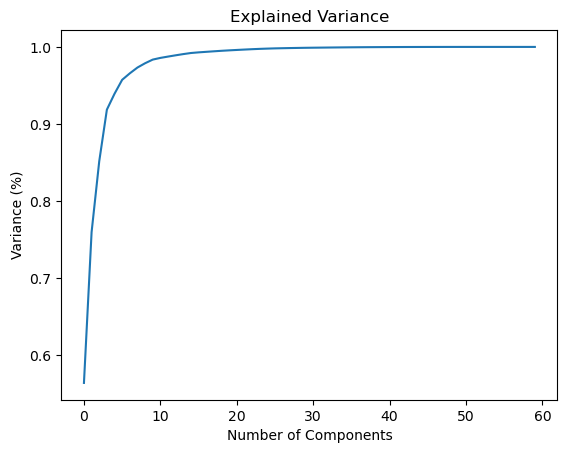

In [9]:
## getting the optimal number of pca
from sklearn.decomposition import PCA
pca = PCA()
principalComponents = pca.fit_transform(data1)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Explained Variance')
plt.show()

### Decision Tree

In [10]:
## Balacing the data
# SMOTE (Synthetic Minority Over-sampling Technique) is a technique used to address class imbalance in machine learning datasets. It's commonly applied to classification problems where one class (the minority class) is significantly underrepresented compared to another class (the majority class).
from collections import Counter# importing counter to check count of each label
from imblearn.over_sampling import SMOTE #for balancing the data
sm=SMOTE()
x_smote,y_smote=sm.fit_resample(x_train,y_train)

In [11]:
print("actual",Counter(y_train))
print("after smote",Counter(y_smote))

actual Counter({'PerformanceRating': 1})
after smote Counter({'PerformanceRating': 1})


In [12]:
# creating decision tree model
from sklearn.tree import DecisionTreeClassifier
dtree=DecisionTreeClassifier() # model 
dtree.fit(x_smote,y_smote)
y_predic=dtree.predict(x_test)

In [13]:
y_train_predict=dtree.predict(x_train)#predicting training data to check training performance 
y_train_predict

array([4, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 2, 3, 4, 3, 2, 3, 3, 4, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3,
       2, 3, 3, 4, 2, 3, 2, 3, 3, 4, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3, 3, 2, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 2, 2, 2, 3, 3, 4, 2, 2, 2, 3, 4, 4, 2, 3, 3, 3,
       3, 3, 3, 3, 2, 2, 2, 3, 3, 2, 2, 3, 3, 4, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 4, 3, 3,
       2, 2, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 4, 3, 2, 3, 2, 3,
       3, 4, 2, 2, 2, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 4, 2, 3, 2, 4,
       3, 3, 2, 3, 3, 4, 2, 3, 3, 2, 3, 3, 3, 2, 3, 3, 3, 3, 2, 3, 4, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 4, 2, 4, 3, 3, 3, 3,
       3, 3, 3, 3, 2, 3, 4, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 4, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 4, 2, 4, 3, 2, 3, 3, 3, 3, 2,

In [14]:
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score,f1_score,classification_report
decisiontree_score=accuracy_score(y_train,y_train_predict)
decisiontree_score

1.0

In [15]:
print("The Accuracy score we achive using decision tree algorithm is :",decisiontree_score)

The Accuracy score we achive using decision tree algorithm is : 1.0


In [16]:
actual_value=y_test.copy()
actual_value
actual_value['pred']=y_predic
# Now we are trying to save these to diffrent name file.
actual_value.to_csv('decisiontree_Accu.csv', index=False)

### Apply Random Forest

In [17]:
# creating
from sklearn.ensemble import RandomForestClassifier
RForest=RandomForestClassifier()
RForest.fit(x_smote,y_smote)
y_pred=RForest.predict(x_test)

In [18]:
accuracy_score(y_test,y_pred)

0.9277777777777778

### HyperParameter Tunning For Random Forest

In [19]:
from sklearn.model_selection import RandomizedSearchCV
n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False] 

In [20]:
#dictionary for hyperparameters
random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf, 'bootstrap': bootstrap}

rf_clf1 = RandomForestClassifier(random_state=42)#model

rf_cv = RandomizedSearchCV(estimator=rf_clf1, scoring='accuracy',
                           param_distributions=random_grid, n_iter=100, cv=3, 
                               verbose=2, random_state=42, n_jobs=-1)
rf_cv.fit(x_smote, y_smote)
rf_best_params = rf_cv.best_params_
print(f"Best paramters: {rf_best_params})")
 

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best paramters: {'n_estimators': 800, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': 100, 'bootstrap': True})


In [22]:
rf_clf2 = RandomForestClassifier(n_estimators= 100, min_samples_split=2, min_samples_leaf= 1, max_features='auto', max_depth=20, bootstrap=False)#passing best parameter to randomforest
rf_clf2.fit(x_smote,y_smote)
y_predict=rf_clf2.predict(x_test)


In [23]:
# training accuracy
y_train_pred=rf_clf2.predict(x_train)

In [24]:
# testing accuracy
randomforest_score=accuracy_score(y_test,y_predict)
randomforest_score

0.9055555555555556

In [25]:
# training accuracy
accuracy_score(y_train,y_train_pred)

1.0

In [26]:
print("The Accuracy score we achive using random forest is :",randomforest_score)

The Accuracy score we achive using random forest is : 0.9055555555555556


In [27]:
actual_value=y_test.copy()
actual_value
actual_value['pred']=y_predict
# Now we are trying to save these to diffrent name file.
actual_value.to_csv('RadondomF_Accu.csv', index=False)

### Apply SVM

In [28]:
# Support Vector Classifier Model
from sklearn.svm import SVC
svclassifier = SVC() ## base model with default parameters
svclassifier.fit(x_smote, y_smote)

SVC()

In [29]:
# Predict output for X_test
y_pred=svclassifier.predict(x_test)

In [30]:
## evaluating the model created
from sklearn.metrics import accuracy_score,recall_score,precision_score,classification_report,f1_score
acc=accuracy_score(y_test,y_pred)
acc

0.6305555555555555

In [31]:
#f1_score(y_test,y_pred)

In [32]:
# Calssification report measures the quality of predictions. True Positives, False Positives, True negatives and False Negatives 
# are used to predict the metrics of a classification report 

print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           2       0.29      0.50      0.37        56
           3       0.86      0.64      0.73       260
           4       0.46      0.75      0.57        44

    accuracy                           0.63       360
   macro avg       0.54      0.63      0.56       360
weighted avg       0.72      0.63      0.66       360



In [33]:
accuracy_score

<function sklearn.metrics._classification.accuracy_score(y_true, y_pred, *, normalize=True, sample_weight=None)>

In [34]:
#grid search CV
from sklearn.model_selection import GridSearchCV

# define hyperparameter range 
param_grid={'C':[0.1,5,10,50,60,70],'gamma':[1,0.1,0.01,0.001,0.001],'random_state':list(range(1,5))}

model=SVC()
grid=GridSearchCV(model,param_grid,verbose=2,scoring='f1',cv=5)
grid.fit(x,y)

Fitting 5 folds for each of 120 candidates, totalling 600 fits
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=3; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, 

[CV] END .......................C=5, gamma=1, random_state=1; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=1; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=1; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=1; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=2; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=2; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=2; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=2; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=2; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=3; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=3; total time=   0.3s
[CV] END .......................C=5, gamma=1, random_state=3; total time=   0.3s
[CV] END ...................

[CV] END ......................C=10, gamma=1, random_state=1; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=1; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=10, gamma=1, random_state=3; total time=   0.3s
[CV] END ...................

[CV] END ......................C=50, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=50, gamma=1, random_state=4; total time=   0.3s
[CV] END ...................

[CV] END ......................C=60, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=2; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=60, gamma=1, random_state=4; total time=   0.3s
[CV] END ...................

[CV] END ......................C=70, gamma=1, random_state=2; total time=   2.7s
[CV] END ......................C=70, gamma=1, random_state=3; total time=   2.5s
[CV] END ......................C=70, gamma=1, random_state=3; total time=   2.6s
[CV] END ......................C=70, gamma=1, random_state=3; total time=   2.6s
[CV] END ......................C=70, gamma=1, random_state=3; total time=   2.5s
[CV] END ......................C=70, gamma=1, random_state=3; total time=   0.3s
[CV] END ......................C=70, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=70, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=70, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=70, gamma=1, random_state=4; total time=   0.3s
[CV] END ......................C=70, gamma=1, random_state=4; total time=   0.3s
[CV] END ....................C=70, gamma=0.1, random_state=1; total time=   0.2s
[CV] END ...................

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 5, 10, 50, 60, 70],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.001],
                         'random_state': [1, 2, 3, 4]},
             scoring='f1', verbose=2)

In [35]:
print(grid.best_params_)

{'C': 0.1, 'gamma': 1, 'random_state': 1}


In [36]:
model=SVC(C=70,gamma=0.01,random_state=1)
model.fit(x_smote,y_smote)

SVC(C=70, gamma=0.01, random_state=1)

In [37]:
y_pred=model.predict(x_test)

In [38]:
Accuracy_SVC=accuracy_score(y_test,y_pred)
Accuracy_SVC

0.725

In [39]:
print("The Accuracy score we achive using Super vecter Machin algorithm is :",Accuracy_SVC)

The Accuracy score we achive using Super vecter Machin algorithm is : 0.725


In [40]:
actual_value=y_test.copy()
actual_value
actual_value['pred']=y_pred
# Now we are trying to save these to diffrent name file.
actual_value.to_csv('SuperVecterMachine_Accu.csv', index=False)

In [41]:
actual_value

,PerformanceRating,pred
1049,3,3
476,2,3
61,3,3
910,4,3
68,4,4
...,...,...
1044,3,3
677,3,3
351,3,3
882,3,2


### Apply Gradient Boosting Algorithm

In [42]:
## importing the model library
from sklearn.ensemble import GradientBoostingClassifier
GradientB=GradientBoostingClassifier() ## object creation
GradientB.fit(x_train,y_train) ## fitting the data
y_gbm=GradientB.predict(x_test)#predicting the price

In [43]:
## evaluatin the model
from sklearn.metrics import accuracy_score,recall_score,precision_score,f1_score,classification_report# to check model performance
GradientB_score=accuracy_score(y_test,y_gbm)
GradientB_score

0.9416666666666667

In [44]:
print("The Accuracy score we achive using gradient bossting is :",GradientB_score)

The Accuracy score we achive using gradient bossting is : 0.9416666666666667


In [45]:
actual_value=y_test.copy()
actual_value
actual_value['pred']=y_gbm
# Now we are trying to save these to diffrent name file.
actual_value.to_csv('GBoost_Accu.csv', index=False)

### K-neighbour (KNN)

In [46]:
# Import KNN algorithm
from sklearn.neighbors import KNeighborsClassifier
# Create empty list to store error values
error_rate = []

for i in range(1, 11):
    KNN = KNeighborsClassifier(n_neighbors=i)
    KNN.fit(x_train, y_train)
    y_pred = KNN.predict(x_test)
    
    # Convert y_test to Series and then apply .ravel()
    error_rate.append(np.mean(y_pred != y_test.iloc[:, 0].ravel()))  # Assuming the target column is the first column

error_rate

[0.36666666666666664,
 0.3972222222222222,
 0.33055555555555555,
 0.33611111111111114,
 0.2861111111111111,
 0.28888888888888886,
 0.275,
 0.28888888888888886,
 0.275,
 0.275]

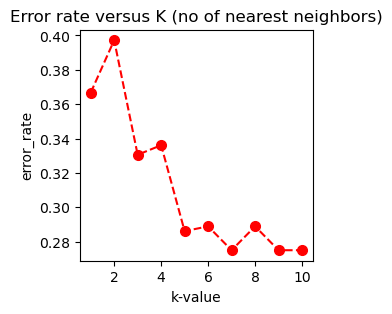

In [47]:
plt.figure(figsize=(3,3))
plt.plot(range(1,11),error_rate,color="red",linestyle="dashed",marker='o',markersize=7)
plt.title("Error rate versus K (no of nearest neighbors)")
plt.xlabel("k-value")
plt.ylabel("error_rate")
plt.show()

In [48]:
# Import KNN algorithm
from sklearn.neighbors import KNeighborsClassifier
# Create empty list to store error values
error_rate = []

for i in range(1, 11):
    KNN = KNeighborsClassifier(n_neighbors=i)
    KNN.fit(x_train, y_train)
    y_pred = KNN.predict(x_test)
    
    # Convert y_test to Series and then apply .ravel()
    error_rate.append(np.mean(y_pred != y_test.iloc[:, 0].ravel()))  # Assuming the target column is the first column

error_rate

[0.36666666666666664,
 0.3972222222222222,
 0.33055555555555555,
 0.33611111111111114,
 0.2861111111111111,
 0.28888888888888886,
 0.275,
 0.28888888888888886,
 0.275,
 0.275]

In [49]:
knn_model=KNeighborsClassifier(n_neighbors=7)
knn_model.fit(x_train,y_train)
y_pred=knn_model.predict(x_test)

In [50]:
# accuracy score
KNN_score=accuracy_score(y_test,y_pred)
KNN_score

0.725

In [51]:
print("The Accuracy score we achive using K-Neighbors is :",KNN_score)

The Accuracy score we achive using K-Neighbors is : 0.725


In [52]:
actual_value=y_test.copy()
actual_value
actual_value['pred']=y_pred
# Now we are trying to save these to diffrent name file.
actual_value.to_csv('KNN_Accu.csv', index=False)

### Using Deep Learning

In [53]:
## Scaling the data as the magnitude of variables are varying lot
from sklearn.preprocessing import StandardScaler
sc=StandardScaler() ## object creation
sclaed_x=sc.fit_transform(x) ## transforming the data
X = pd.DataFrame(sclaed_x,columns=x.columns) ##converting the arrays

### ANN (Artificial Neural Network)

In [54]:
## model creation
from sklearn.neural_network import MLPClassifier
ANN = MLPClassifier( hidden_layer_sizes=(50,3),
                       learning_rate_init=0.1,
                       max_iter=100,
                       random_state=2) ## model object creation max_iter=Stopping parameter
ANN.fit(x_train,y_train) ## training the data
y_predict_proba = ANN.predict_proba(x_test) ## predicting the pro
## bability of class
y_predict = ANN.predict(x_test)
y_train_predict = ANN.predict(x_train)

In [55]:
y_train_predict

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

In [56]:
## Evaluating the model created
from sklearn.metrics import accuracy_score,confusion_matrix
print("Train accuracy :",accuracy_score(y_train,y_train_predict))
ANN_score=accuracy_score(y_test,y_predict)
print("Test accuracy :",ANN_score)

Train accuracy : 0.7309523809523809
Test accuracy : 0.7222222222222222


In [57]:
print("The Accuracy score we achive using artificial nural network is :",ANN_score)

The Accuracy score we achive using artificial nural network is : 0.7222222222222222


In [58]:
actual_value=y_test.copy()
actual_value
actual_value['pred']=y_predict
# Now we are trying to save these to diffrent name file.
actual_value.to_csv('ANN_Acc.csv', index=False)

# Conclusion 

In [59]:
accuracy_scores = [decisiontree_score,randomforest_score,Accuracy_SVC,GradientB_score,KNN_score,ANN_score]
algorithms = ["Decision Tree","Random Forest","Supper Vector Machine","Gradient Boosting","K-Nearest Neighbors","Artificial Nueral Network"]   

for i in range(len(algorithms)):
    print("The accuracy score achieved using "+algorithms[i]+" is: "+str(accuracy_scores[i])+" %")

The accuracy score achieved using Decision Tree is: 1.0 %
The accuracy score achieved using Random Forest is: 0.9055555555555556 %
The accuracy score achieved using Gradient Boosting is: 0.9416666666666667 %
The accuracy score achieved using K-Nearest Neighbors is: 0.725 %
The accuracy score achieved using Artificial Nueral Network is: 0.7222222222222222 %


<Axes: xlabel='Algorithms', ylabel='Accuracy score'>

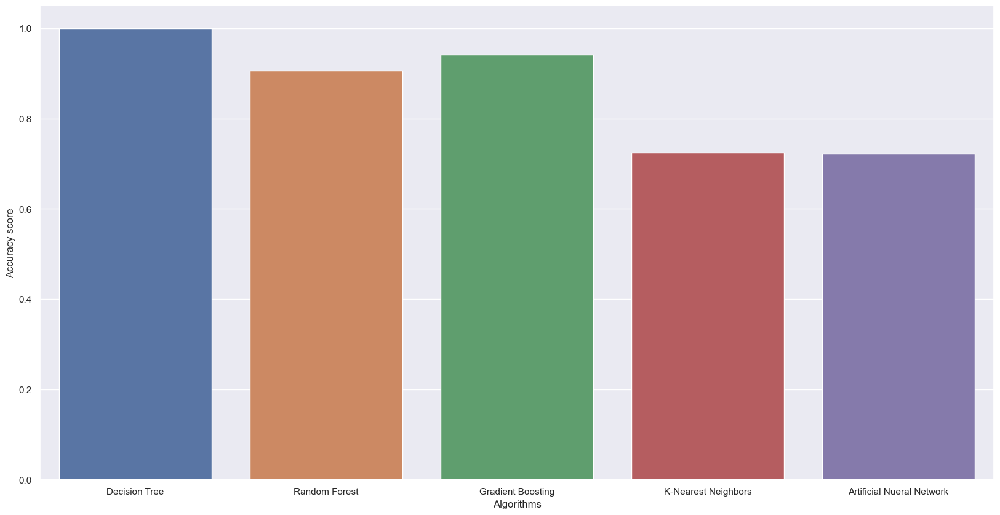

In [60]:
sns.set(rc={'figure.figsize':(20,10)})
plt.xlabel("Algorithms")
plt.ylabel("Accuracy score")

sns.barplot(x=algorithms,y=accuracy_scores)

### Conclusion and  Recommendation

* Within all the five models Three model gives more accuracy score followed closely by K-Nearest Neighbors and ANN
* While ANN had the lowest performance.
* ie; Here the best model is 
  * 1.Decision Tree
  * 2.Random Forest
  * 3.Gradient Boosting
  * 4.XG-Boost 
  
### so we have to go with  1.Decision Tree Random Forestprediction 

- Read file of 
  * 1.Decision Tree
  * 2.Random Forest

Establish measurable goals and milestones to track progress. Clearly define performance expectations and objectives for the employee. Collaborate with the employee to develop a personalized action plan for development. When discussing performance improvement with an employee, it's crucial to maintain a respectful and constructive dialogue. Focus on providing support, guidance, and opportunities for growth to help the employee reach their full potential. Because 

In conclusion, this project has provided valuable insights into which factors influencing employee performance,
with implications for devloper and senior devloper Moving forward, 
it is essential to hire employee according to model file (In Which I saved the model). have to hire more employee who left job in department.

### The model Deployment Technique

In [129]:
#!pip install joblib otherwise pickle

In [61]:
import joblib

# Create a dictionary to store the models
models = {
    "Decision Tree":decisiontree_score,
"Random Forest":randomforest_score,
"Gradient Boosting":GradientB_score,
"K-Nearest Neighbors":KNN_score,
"Artificial Nueral Network":ANN_score
}

# Save the dictionary of models to a single pickle file
joblib.dump(models, 'all_modelsMJ.pkl')

['all_modelsMJ.pkl']

In [62]:
# Load the dictionary of models from the pickle file
loaded_models = joblib.load('all_modelsMJ.pkl')

# Access individual models as needed
Dicesion_model = loaded_models['Decision Tree']
#gradient_boosting_model = loaded_models['gradient_boosting']
# ... and so on


# Thank You